# Simulating 2D Lennard-Jones gas in circular reflective boundaries

In [ ]:
import numpy as np, matplotlib.pyplot as plt
from numba import njit

Select arguments of the simulation

In [ ]:
args = dict(output_dir='../data/raw/synthLJ_21/',
            num_train=200, num_val=200, num_test=2000,
            # num_time_steps=50,
           )

## Reflective circular boundaries

In [ ]:
# from https://github.com/AnDiChallenge/andi_datasets/blob/master/andi_datasets/utils_trajectories.py#L172C5-L248C5
@njit
def circle_line_segment_intersection(circle_center, circle_radius,
                                     pt1, pt2,
                                     full_line=False, tangent_tol=1e-16):
    """
    Find the points at which a circle intersects a line-segment.
    This can happen at 0, 1, or 2 points.

    Parameters
    ----------
    circle_center : tuple
        The (x, y) location of the circle center.
    circle_radius : float
        The radius of the circle.
    pt1 : tuple
        The (x, y) location of the first point of the segment.
    pt2 : tuple
        The (x, y) location of the second point of the segment.
    full_line : bool
        True to find intersections along full line - not just in the segment.
        False will just return intersections within the segment.
    tangent_tol : float
        Numerical tolerance at which we decide the intersections are close enough to consider it a tangent.

    Returns
    -------
    Sequence[Tuple[float, float]]
        A list of length 0, 1, or 2, where each element is a point at which the circle intercepts a line segment.
    """

    (p1x, p1y), (p2x, p2y), (cx, cy) = pt1, pt2, circle_center
    (x1, y1), (x2, y2) = (p1x - cx, p1y - cy), (p2x - cx, p2y - cy)
    dx, dy = (x2 - x1), (y2 - y1)
    dr2 = (dx ** 2 + dy ** 2)
    dr = dr2**.5
    big_d = x1 * y2 - x2 * y1
    discriminant = circle_radius ** 2 * dr2 - big_d ** 2

    if discriminant < 0:  # No intersection between circle and line
        #return []
        return [(float(x),float(x)) for x in range(0)] # empty list with Numba inferable type float
    else:  # There may be 0, 1, or 2 intersections with the segment
        intersections = [
            (cx + ( big_d * dy + sign * (-1 if dy < 0 else 1) * dx * discriminant**.5) / dr2,
             cy + (-big_d * dx + sign * abs(dy) * discriminant**.5) / dr2)
            for sign in ((1, -1) if dy < 0 else (-1, 1))]  # This makes sure the order along the segment is correct
        if not full_line:  # If only considering the segment, filter out intersections that do not fall within the segment
            fraction_along_segment = [(xi - p1x) / dx if abs(dx) > abs(dy) else (yi - p1y) / dy for xi, yi in intersections]
            intersections = [pt for pt, frac in zip(intersections, fraction_along_segment) if 0 <= frac <= 1]
        if len(intersections) == 2 and abs(discriminant) <= tangent_tol:  # If line is tangent to circle, return just one point (as both intersections have same location)
            return [intersections[0]]
        else:
            return intersections

@njit
def seg_to_vec(seg):
    ''' Find the vector given a segment created by two 2D points'''
    return np.array([(seg[0][0]-seg[1][0]), (seg[0][1]-seg[1][1])])

#@njit
def ang_vec(vA, vB):
    ''' Calculates the angle between two vectors'''
    # Get dot prod
    dot_prod = np.dot(vA, vB)
    # Get magnitudes
    magA = np.dot(vA, vA)**0.5
    magB = np.dot(vB, vB)**0.5
    # Get cosine value
    cos_ = dot_prod/magA/magB
    # Get angle in radians and then convert to degrees
    return np.arccos(np.clip(dot_prod/magB/magA, -1, 1)) # in radians [0, pi]

@njit
def get_angle(from_vec, # T, d=2
              to_vec,   # T, d=2
              ):
    ''' Calculates the angle between two vectors'''
    x1, y1 = from_vec[...,0], from_vec[...,1]
    x2, y2 = to_vec[...,0], to_vec[...,1]
    dot = x1*x2 + y1*y2      # Dot product between [x1, y1] and [x2, y2]
    det = x1*y2 - y1*x2      # Determinant (cross2d) # 2.53 micros, njit 256 ns
    return np.arctan2(det, dot) # Array of angles in radians, in the range ``[-pi, pi]``

# @njit
# def get_angle(from_vec, # d=2
#               to_vec,   # d=2
#               ):
#     x1, y1 = from_vec[0], from_vec[1]
#     x2, y2 = to_vec[0], to_vec[1]
#     dot = x1*x2 + y1*y2      # Dot product between [x1, y1] and [x2, y2]
#     det = x1*y2 - y1*x2      # Determinant (cross2d) # 2.53 micros, njit 256 ns
#     return np.arctan2(det, dot)

@njit
def ang_line(lineA, lineB):
    ''' Calculates the angle between two lines/segments'''
    # Get vector form
    vA = seg_to_vec(lineA)
    vB = seg_to_vec(lineB)
    return get_angle(vA,vB)
    # return ang_vec(vA, vB)

@njit
def rotate_vec(vec, angle):
    return np.array([ vec[0]*np.cos(angle) + vec[1]*np.sin(angle),
                     -vec[0]*np.sin(angle) + vec[1]*np.cos(angle)])

# from https://github.com/AnDiChallenge/andi_datasets/blob/master/andi_datasets/models_phenom.py#L1117
@njit
def reflect(circle_radius,
            beg,
            end, vel,
            circle_center=np.zeros(2),
            precision_boundary = 1e-14):
        '''
        Given the begining and end of a segment crossing the boundary of a circle,
        calculates the new position considering that boundaries are fully reflective.

        Parameters
        ----------
        circle_radius : float
            Radius of the circle
        beg : tuple
            Position (in 2D) of the begining of the segment
        end : tuple
            Position (in 2D) of the begining of the segment
        circle_center : float
            Center of the circle
        precision_boundary : float
            Small area around the real boundary which is also considered as boundary. For numerical stability

        Returns
        -------
        tuple
            - Reflected position
            - Intersection point

        '''
        beg = np.asarray(beg)
        # If the begining of the segment is in the exact boundary, no intersection is found.
        # In that case, we bring closer the point to the center of the cercle so it is
        # at a distance 'precision_boundary' from the border
        if np.linalg.norm(circle_center - beg) > (circle_radius - precision_boundary): # This is cheking if the beg is outside circle-precision, right??
            vec = seg_to_vec([circle_center, beg])
            beg = circle_center+\
                 (circle_radius-precision_boundary)*(-vec/np.linalg.norm(vec))

        # find the intersection between the line drawn by the displacement and the circle
        intersect = circle_line_segment_intersection(circle_center = circle_center,
                                                           circle_radius = circle_radius,
                                                           pt1 = beg,
                                                           pt2 = end)[-1]
        intersect = np.array(intersect)

        # Draw lines and calculate angles between radius and begining-intersection
        line1 = [circle_center, intersect]
        line2 = [beg, intersect]
        angle = ang_line(line1, line2)

        # Calculate distance between intersection and end of displacement
        dist_int_end = np.linalg.norm(intersect - end)

        # Create radius vector and calculate the tangent vector
        vec_radius = seg_to_vec([circle_center, intersect])
        tangent = rotate_vec(vec_radius, np.pi*.5)

        # Calculate the angle between the tangent and the displacement vector
        # angle_tan = ang_vec(tangent, seg_to_vec([beg, intersect]))
        angle_tan = get_angle(tangent, seg_to_vec([beg, intersect]))

        # rotate velocity
        vel_bounce = rotate_vec(vel, np.pi+2*angle)

        # Change sign to correct get the reflection
        #if angle_tan < np.pi*.5: angle = - angle

        # Rotate the radius vector with the reflection angle and normalize by magnitude
        vec_bounce = rotate_vec(vec_radius, angle)
        vec_bounce /= np.dot(vec_bounce, vec_bounce)**0.5

        # Final point is the previous vector times the distance starting at the intersect point
        return intersect+dist_int_end*vec_bounce, vel_bounce, intersect

In [ ]:
@njit
def reflective_circle_boundary(rbeg, # N,2
                               rend, R, vend):
    refl_i = (rend**2).sum(-1) > R**2  # mask
    if np.any(refl_i):  # particles outside circle
        refl_i = np.flatnonzero(refl_i)
        # if reflect function would work on arrays
        #rend[refl_i], vend[refl_i], _ = reflect(R,rbeg[refl_i],rend[refl_i],vend[refl_i], precision_boundary=1e-15)
        for i in refl_i:
            rend[i], vend[i], _ = reflect(R,rbeg[i],rend[i],vend[i], precision_boundary=1e-15)
        # reflections: r_refl, v_refl
    return rend, vend

def reflective_circle_boundary_(rbeg, # 2
                               rend, R, vend):
    if (rend**2).sum(-1) > R**2:  # particle outside circle
        # r_refl, v_refl
        rend, vend , _= reflect(R,rbeg,rend,vend, precision_boundary=1e-15)
    return rend, vend

In [ ]:
k = 1e-6
circle_radius = 2*k
particle_radius= 0.1*k
beg = np.array([0,0])*k
end = np.array([1.1,2.2])*k
vel = 10*np.array(seg_to_vec([end, beg]))*k
end_r, vel_r, intersect = reflect(circle_radius,beg,end,vel, )

In [ ]:
end_r, vel, vel_r

(array([6.88854382e-07, 1.37770876e-06]),
 array([1.1e-11, 2.2e-11]),
 array([-1.1e-11, -2.2e-11]))

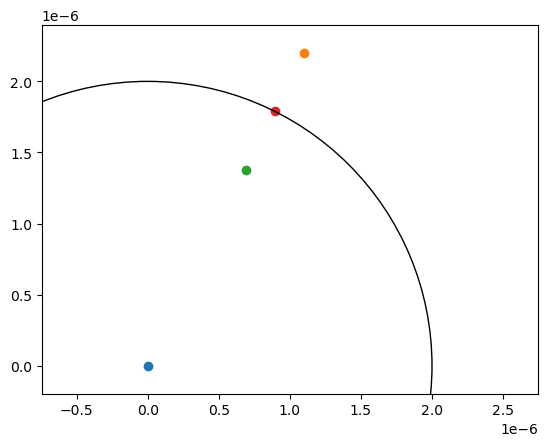

In [ ]:
for x in [beg, end, end_r,intersect]:
    plt.scatter(*x);
plt.gca().add_patch(plt.Circle((0,0),radius=circle_radius,fill=None));
plt.axis('equal');
plt.gca().set(xlim=(0.5*k,1.5*k),ylim=(-.2*k,2.4*k));

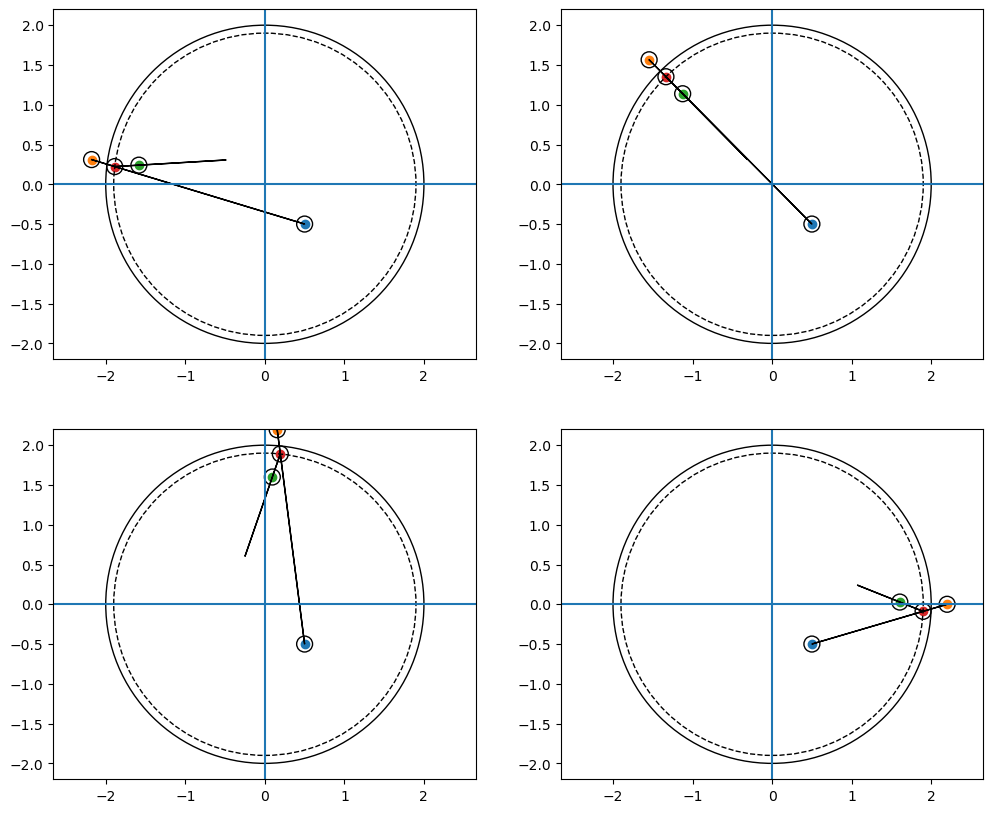

In [ ]:
k = 1.
circle_radius = 2*k
particle_radius= 0.1*k
beg = np.array([0.5,-.5])*k
thetas = [3.,2.35, 1.5, 0]
fig, axs = plt.subplots(2,len(thetas)//2, figsize=(12,10))
axs = axs.flatten()
for theta, ax in zip(thetas, axs):
    end = circle_radius*1.1*np.array([np.cos(theta),np.sin(theta)])*k
    vel = 10*np.array(seg_to_vec([end, beg]))*k
    end_r, vel_r, intersect = reflect(circle_radius-particle_radius,beg,end,vel, )

    for x in [beg, end, end_r,intersect]:
        ax.add_patch(plt.Circle(x,radius=particle_radius,fill=None));
        ax.scatter(*x);
    ax.arrow(*beg, *(vel*.1))
    ax.arrow(*intersect, *(vel_r*.05))
    ax.add_patch(plt.Circle((0,0),radius=circle_radius,fill=None));
    ax.add_patch(plt.Circle((0,0),radius=circle_radius-particle_radius,fill=None, ls='--'));
    ax.axis('equal');
    margin = 1.1
    ax.set(xlim=(-circle_radius*margin,circle_radius*margin),ylim=(-circle_radius*margin,circle_radius*margin));
    ax.axhline(0);ax.axvline(0);

In [ ]:
# adapted from https://github.com/FidhaNazreen/Active-Brownian-Motion-in-2D
kB = 1.38*(10**(-23))                           #Boltzmann constant [J/K]
T = 300                                         #Temperature [K]
eta = 0.001                                     #Fluid Viscosity [N s/m^2]
R = 1 *10**(-6)                                 #Radius of the particle [m]
DT = (kB*T)/(6*(np.pi)*eta*R)                   #Translational Diffusion Coefficient [m^2/s]
DR = (kB*T)/(8*(np.pi)*eta*R**(3))              #Rotational Diffusion Coefficient [rad^2/s]
omega = 0                                       #angular velocity [rad/sec]
v_ = 5*10**(-6)   
#Specifying the value of 'v' as 0, 5 and 10 μm/s will yield figures 3 a), b) and c) respectively

Rc = 10*10**(-6)                  #radius of the circle in which the particle to be confined



t0 = 0
tf = 10#0
dt = 0.001
t = np.arange(t0,tf,dt)
n = int((tf-t0)/dt)



q = np.array([0,0])

#r_all=[]

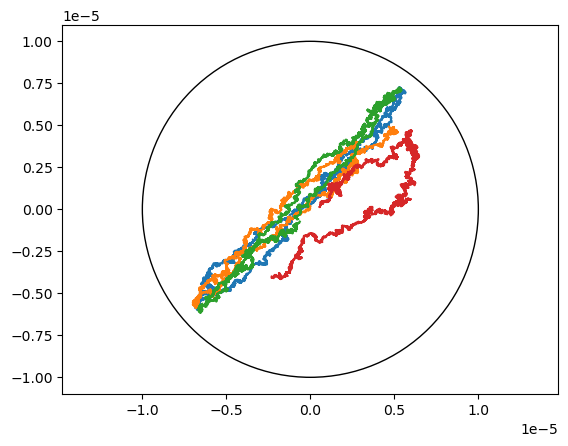

In [ ]:
for j in range(4): # number of particles
    theta = np.zeros(n+1)
    r = np.zeros((n+1,2))

    theta[0] = np.random.randn()*10**(-6)
    r[0] = np.random.randn(2)*10**(-6)
    for k in range(n): # steps
        temp_r = r[k] + v_*np.array([np.cos(theta[k]),np.sin(theta[k])]) * dt + np.sqrt(2 * DT *dt)*np.random.randn(2)

        r[k+1], theta_v = reflective_circle_boundary_(r[k], temp_r, Rc-R, v_*np.array([np.cos(theta[k]),np.sin(theta[k])]))
        # if (temp_r**2).sum(-1) <= (Rc-R)**2: # particle inside circle
        #     r[k+1] = temp_r
        #     #r_all.append(temp_r)
        # else: # outside, then reflect
        #     end_r, vel_r, intersect = reflect(Rc-R,r[k],temp_r,np.array([np.cos(theta[k]),np.sin(theta[k])]), precision_boundary=1e-15)
        #     r[k+1]= end_r
        theta_ = np.arctan2(*(theta_v /v_))
        # temp_theta = theta[k] + omega * dt + np.sqrt(2 * DR  * dt)*np.random.randn()
        theta[k+1] = theta_ + omega * dt + np.sqrt(2 * DR  * dt)*np.random.randn()


    plt.plot(*r.T)

plt.gca().add_patch(plt.Circle((0,0),radius=Rc,fill=None));
plt.gca().axis('equal');
# plt.axis('off')
# plt.show()

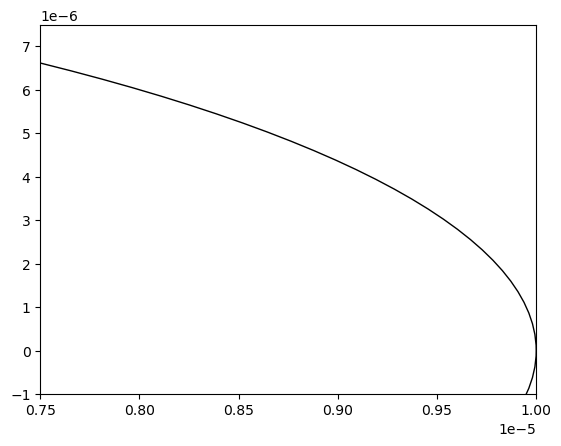

In [ ]:
plt.plot(*r.T)

plt.gca().add_patch(plt.Circle((0,0),radius=Rc,fill=None));
plt.xlim(.75e-5,1e-5)
plt.ylim(-.1e-5,.75e-5);

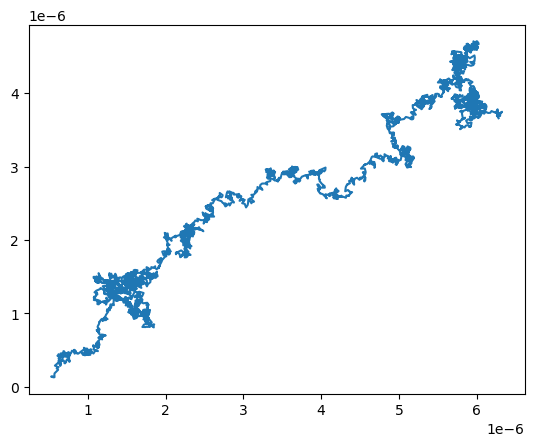

In [ ]:
plt.plot(*r[:4000].T);

## Simulator

In [ ]:
from numba import njit
from tqdm.auto import trange, tqdm

$U_{LJ}=4\epsilon \left(\frac{\sigma^{12}}{r^{12}}-\frac{\sigma^{6}}{r^6}\right)$

$\vec{F}_{LJ}=-\vec{\nabla}U=4\epsilon \left(\frac{12\sigma^{12}}{r^{13}}-\frac{6\sigma^{6}}{r^7}\right)=24\epsilon \frac{\sigma^{6}}{r^6}\left(\frac{2\sigma^{6}}{r^{6}}-1\right)\frac{\hat{r}}{r}$

In [ ]:
@njit(fastmath=True)
def force (r,   # positions (N,d)
           box, # box length
           r_cut=2.5, ):
    """Takes in box, cutoff range, and coordinate array, and calculates forces and potentials etc."""
    # It is assumed that positions are in units where box = 1
    # Forces are calculated in units where sigma = 1 and epsilon = 1

    n, d = r.shape
    #assert d==3, 'Dimension error in force'

    sr2_ovr      = 1.77 # Overlap threshold (pot > 100)
    r_cut_box    = r_cut / box
    r_cut_box_sq = r_cut_box ** 2
    box_sq       = box ** 2

    # Calculate potential at cutoff
    sr2     = 1.0 / r_cut**2 # in sigma=1 units
    sr6     = sr2 ** 3
    sr12    = sr6 **2
    pot_cut = sr12 - sr6 # Without numerical factor 4

    # Initialize
    f = np.zeros_like(r)
    cut=0.0; pot=0.0; vir=0.0; lap=0.0; ovr=False

    for i in range(n-1):
        rij       = r[i:i+1]-r[i+1:]                        # Separation vectors for j>i
        # rij       = rij - np.rint(rij)                      # Periodic boundary conditions in box=1 units
        rij_sq    = np.sum(rij**2,axis=-1)                   # Squared separations for j>1, sum in d
        in_range  = rij_sq < r_cut_box_sq                   # Set flags for within cutoff
        rij_sq    = rij_sq * box_sq                         # Now in sigma=1 units
        rij       = rij * box                               # Now in sigma=1 units
        sr2       = np.where ( in_range, 1.0/rij_sq, 0.0 )  # (sigma/rij)**2, only if in range
        ovr_      = sr2 > sr2_ovr                           # Overlap if too close
        sr6       = sr2 ** 3
        sr12      = sr6 ** 2
        cut_      = sr12 - sr6                              # LJ pair potential (cut but not shifted)
        vir_      = cut_ + sr12                             # LJ pair virial
        pot_      = np.where ( in_range, cut_-pot_cut, 0.0 )# LJ pair potential (cut-and-shifted)
        lap_      = ( 22.0*sr12 - 5.0*sr6 ) * sr2           # LJ pair Laplacian
        fij       = vir_ * sr2                              # LJ scalar part of forces
        fij       = rij * fij[:,None]                       # LJ pair forces
        cut+=np.sum(cut_);
        pot+=np.sum(pot_)
        vir+=np.sum(vir_);
        lap+=np.sum(lap_);
        ovr= ovr or np.any(ovr_)
        assert not ovr, i
        f[i]    = f[i] + np.sum(fij,axis=0)
        f[i+1:] = f[i+1:] - fij


    # Multiply results by numerical factors
    f   = f   * 24.0       # 24*epsilon
    cut = cut * 4.0        # 4*epsilon
    pot = pot * 4.0        # 4*epsilon
    vir = vir * 24.0 / 3.0 # 24*epsilon and divide virial by 3
    lap = lap * 24.0 * 2.0 # 24*epsilon and factor 2 for ij and ji

    return pot, f, cut, vir, lap, ovr

‘BAOAB’ method from https://arxiv.org/abs/1203.5428 appendix

$B:\quad p_{n+1/2} = p_n - \delta t \nabla U(x_n)/2 = p_n + \delta t F(x_n)/2$;

$A:\quad x_{n+1/2} = x_n + \delta t M^{-1}p_{n+1/2}/2 = x_n + \delta t v_{n+1/2}/2 $;

$O:\quad p_{n+1/2} = c_1p_{n+1/2} + c_3M^{1/2}R_{n+1}$;

$A:\quad x_{n+1\phantom{/2}} = x_{n+1/2} + \delta t M^{-1}p_{n+1/2}/2$;

$B:\quad p_{n+1\phantom{/2}} = p_{n+1/2} - \delta t \nabla U(x_{n+1})/2$;

In [ ]:
# function with LJ Tildesley force and BAOAB Langevin velocity-Verlet integrator
# https://github.com/Allen-Tildesley/examples/blob/master/python_examples/bd_nvt_lj.py
@njit
def a_propagator (r, v, t):
    """A: drift step propagator.
    t is the time over which to propagate (typically dt/2).
    r, v, and box are accessed from the calling program.
    """
    # r = r + t * v / box   # Positions in box=1 units
    # r = r - np.rint ( r ) # Periodic boundaries
    return r + v * t

@njit
def b_propagator (v, f, t):
    """B: kick step propagator.

    t is the time over which to propagate (typically dt/2).
    v is accessed from the calling program.
    """
    return v + t * f

@njit
def o_propagator (v, n, d, temperature, gamma, t):
    """O: friction and random contributions propagator.

    t is the time over which to propagate (typically dt).
    v, n, temperature, and gamma are accessed from the calling program.
    d is dimensions.
    """
    x = gamma*t
    c = -np.expm1(-2*x) # 1-exp(-2*x), preserving accuracy for small x
    c = np.sqrt(c)
    return v*np.exp(-x) + c*np.sqrt(temperature)*np.random.randn(n,d)

In [ ]:
def simulate_baoab(pos, vel, t_steps, dt, sigma,eps,m, L,
                      rcut=2.5, # bcond='pbc', use_memmap=False, fname='simulation',
                      Tin=None, t_thermostat=None, gamma=None,
                     ):
    N, Ndim = pos.shape[:2]
    dth = dt*.5
    # if not use_memmap:
    forces = np.zeros((N,Ndim,t_steps))
    pot = np.zeros(t_steps)
    vrl = np.zeros(t_steps)
    # else:
    #     forces = np.memmap(fname+'_forces.dat', dtype='float64', mode='w+', shape=(N,Ndim,t_steps))
    #     pot = np.memmap(fname+'_pot.dat', dtype='float64', mode='w+', shape=(t_steps))
    #     vrl = np.memmap(fname+'_vrl.dat', dtype='float64', mode='w+', shape=(t_steps))

    # initial potential and forces at t=0-0.5Δt to log initial force, potential and virial
    pot_, f, cut, vir, lap, ovr = force(pos[...,0]/L, L, rcut) # Force evaluation
    pot[...,0] = pot_
    forces[...,0] = F = f
    vrl[...,0] = vir
    assert not ovr, f'Overlap in configuration {0}'

    ###################################################################

    for t in trange(t_steps-1, leave=False):
        vel[...,t+1] = b_propagator(vel[...,t], f, dth)                   # B kick half-step
        pos[...,t+1] = a_propagator(pos[...,t], vel[...,t+1], dth)        # A drift half-step
        # check boundaries
        pos[...,t+1], vel[...,t+1] = reflective_circle_boundary(pos[...,t], pos[...,t+1], (L-sigma)*.5, vel[...,t+1])

        vel[...,t+1] = o_propagator(vel[...,t+1], N,Ndim, Tin, gamma, dt) # O random velocities and friction step
        pos[...,t+1] = a_propagator(pos[...,t+1], vel[...,t+1], dth)      # A drift half-step
        # check boundaries
        pos[...,t+1], vel[...,t+1] = reflective_circle_boundary(pos[...,t], pos[...,t+1], (L-sigma)*.5, vel[...,t+1])

        pot[...,t+1], f, cut, vrl[...,t+1], lap, ovr = force(pos[...,t+1]/L, L, rcut) # Force evaluation
        forces[...,t+1] =  f
        assert not ovr, f'Overlap in configuration {t+1}'

        vel[...,t+1] = b_propagator(vel[...,t+1], f, dth)                # B kick half-step

    return pos, vel, pot, forces, vrl

## Init

Initialize parameters of the system

In [ ]:
N = 21 # number of particles
d = 2  # number of dimensions # 2D gas
T = 50 # timeseries steps

# units sytem
sigma = 1. # particles diameter
m0 = 1.; eps = 1.
kb = kB = 1. # 1.380649e-23  # [J/K] Boltzmann constant
t0 = sigma*np.sqrt(m0/eps)
v0 = np.sqrt(eps/m0)
F0 = eps/sigma;
T0 = eps/kB;
m = m0

R = sigma/2. # particles radius
rcut = 2.5 * sigma  # LJ cutoff

rho = 0.3# 0.12  #0.72 #  0.052 # 0.053  #9#0.8442
pf=0.74
Rbox = np.sqrt(N/(2*np.pi*rho*pf)) # radius of the boundaries
L = 2*Rbox

dt = 0.0025*t0 # 0.001*t0#0.005*t0#1e-4#0.001
t_steps = 40_000 #20_000 # 40_000
t_int = np.arange(t_steps)*dt; # timestamp for positions
t_int_h = t_int - .5 * dt      # timestamp for velocity, kinetic and potential energies, forces, distances, and virial
# tsim should be on the order of 100 t0, this is 100 t0 /dt steps of dt
print(t0, 100*t0,100*t0/dt, t_steps, t_steps*dt)
assert t_steps*dt>50*t0

Tin = 0.457 # 0.42 # 0.435 # 0.48   #0.85 #0.728 #0.85 #0.5*v**2 # kB *T /eps Temperature
gamma = 1.# friction constant, inverse of time
dump = 1./gamma #

1.0 100.0 40000.0 40000 100.0


In [ ]:
V = 10
W = 0

rn = min(4*sigma, 0.49*2.*Rbox) #None #10*sigma # max distance for the neighbor list
if rn is not None: assert rn<Rbox, 'rn must be smaller than half\
    the length of the box to avoid self-interaction and double counting'
bcond='pbc'

rng  = np.random.default_rng(None)

print(N, rho, Tin)

21 0.3 0.457


In [ ]:
# kinetic energy from temperature check
v_T = np.sqrt(2*Tin/m)  # 2*v0
K_pair = m*v_T**2;
rmin = sigma*(2/(1+np.sqrt(1+K_pair/eps)))**(1/6)
print(rmin)
assert rmin > 0.5

0.9711879073648132


In [ ]:
# v dt should be less than sigma
print(v_T*dt, sigma, sigma/v_T/dt)
assert v_T*dt < sigma

0.002390083680543424 1.0 418.395392655304


In [ ]:
# v dt should be less than sigma
print((v_T+V)*dt, sigma, sigma/(v_T+V)/dt)
assert (v_T+V)*dt < sigma

0.027390083680543423 1.0 36.50956352171904


### Initialize state variables

In [ ]:
r = np.zeros((N,d,t_steps), dtype=float) # position
v = np.zeros((N,d,t_steps), dtype=float) # velocity
# Fully connected without self-connection edges of type: 0 non-interaction, 1 LJ interaction
e = np.zeros((N*(N-1),T), dtype=int)

# rng = np.default_rng()

### Initial Positions have no overlaps and are centered in the center of mass

We fill a circle with N particles avoiding overlaps that lead to bad simulations.

In [ ]:
from scipy.spatial.distance import pdist

In [ ]:
def fill_circle(N: int, Rmax: float):
    """
    Generate a circle of radius R with N particles.

    Parameters:
    N (int): Number of particles
    R (float): Radius of the circle

    Returns:
    numpy array: x and y coordinates of the particles
    """
    # Generate random angles for the particles
    theta = np.random.uniform(0, 2*np.pi, N)
    R = np.sqrt(np.random.uniform(0,1, N))*Rmax # sqrt to uniformly fill the circle

    # Calculate the x and y coordinates of the particles
    return np.stack((R * np.cos(theta), R * np.sin(theta)),axis=-1)

# example
# # Generate a circle with 100 particles and radius 5
# N = 10000
# R = 5
# p = fill_circle(N, Rbox)

# # Plot the circle
# plt.figure(figsize=(8, 8))
# plt.scatter(*p.T, s=10, c='b')
# plt.title("Circle of Particles")
# plt.axis('equal')
# plt.show()

In [ ]:
def fill_circle_nooverlap(N: int, Rmax: float, sigma: float, max_attempts:int=20, p=None):
    """
    Generate a circle of radius Rmax with N particles.

    Parameters:
    N (int): Number of particles
    R (float): Radius of the circle

    Returns:
    numpy array: x and y coordinates of the particles
    """
    if p is None: p = np.zeros((N,2))
    for i in range(N):
        if np.all(p[i]==(0.,0.)): # guess now
            theta = np.random.uniform(0, 2*np.pi)
            r = np.sqrt(np.random.uniform(0,1))*Rmax # sqrt to uniformly fill the circle
            p[i] = (r * np.cos(theta), r * np.sin(theta))
        overlaps = sum(pdist(p[:i+1])<sigma)  # compute overlaps
        attempts = 0
        while overlaps > 0:
            theta = np.random.uniform(0, 2*np.pi)
            r = np.sqrt(np.random.uniform(0,1))*Rmax # guess a new position
            p[i] = (r * np.cos(theta), r * np.sin(theta))
            overlaps = sum(pdist(p[:i+1])<sigma)  # recompute overlaps
            attempts += 1
            if attempts == max_attempts:
                print(f'Surpassed max attempts at {i=} with {overlaps=} under {R=}')
                break
    # Calculate the x and y coordinates of the particles
    return p

# example
# # # Generate a circle with 100 particles and radius 5
# # N = 1000
# # R = 5
# p = fill_circle_nooverlap(30, Rbox, 2*R)

# # Plot the circle
# plt.figure(figsize=(8, 8))
# plt.scatter(*p.T, s=10, c='b');
# # plt.title("Circle of Particles")
# # plt.axis('equal')
# # plt.show()

In [ ]:
def rotate_d(d, angle):
    return np.cos(angle)*d, np.sin(angle)*d

In [ ]:
def lattice_hex(Rhex,Rbox, s=2):
    assert s>=2
    Nrings = int(Rbox/((s+.5)*Rhex))+1  # how many rings fit inside the circle
    chn  = 3*Nrings*(Nrings-1)+1  # centered hexagonal number
    rhex = np.zeros((chn, 2))
    i = 0
    for n in range(1,Nrings):
        d = n*Rhex*s
        for angle in np.linspace(0,2*np.pi,6*n+1)[1:]:
            i+=1
            rhex[i] = rotate_d(d if (i)%n==0 else d-Rhex
                               ,angle)
    rhex =  rhex + np.random.rand(*rhex.shape)*(Rhex*(s-2)*.3)
    return  rhex
# Rhex = 1
# Rbox_ = 11
# s = 3
# rhex = lattice_hex(Rhex,Rbox_, s)

In [ ]:
# from matplotlib.collections import PatchCollection
# circles = [plt.gca().add_patch(plt.Circle((xi,yi), radius=Rhex, fill=None))
#            for xi,yi in zip(rhex[:,0], rhex[:,1])]
# # circles_collection = PatchCollection(circles,)
# # plt.gca().add_collection(circles_collection);
# plt.scatter(*rhex.T);
# plt.gca().add_patch(plt.Circle((0,0),radius=Rbox,fill=None));
# plt.axis('equal');

In [ ]:
for a in range(20_000):
    r[...,0] = lattice_hex(R,Rbox*1.5,s=2.5)[:N] #fill_circle_nooverlap(N,Rbox-R, sigma)
    # check there are no overlaps of the particles
    overlaps = sum(pdist(r[...,0])<1.01*sigma)
    assert overlaps == 0, f'There are {overlaps = }.'

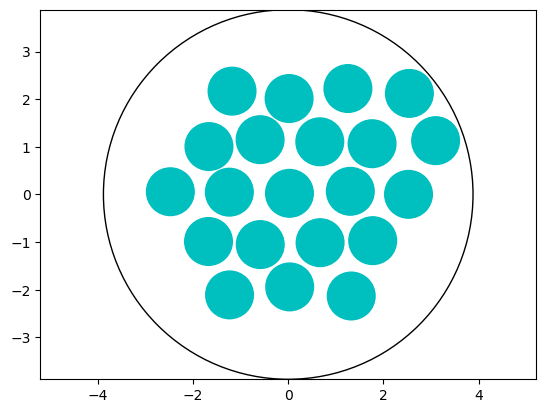

In [ ]:
try:
    from matplotlib.collections import PatchCollection
    circles = [plt.Circle((xi,yi), radius=R, lw=0)
               for xi,yi in zip(r[:,0,0], r[:,1,0])]
    circles_collection = PatchCollection(circles,color='c')
    plt.gca().add_collection(circles_collection);
except:
    plt.scatter(*r[...,0].T, s=10,);
plt.gca().add_patch(plt.Circle((0,0),radius=Rbox,fill=None));
plt.axis('equal');
plt.gca().set(xlim=(-Rbox,Rbox),ylim=(-Rbox,Rbox));

We substract the center of mass

In [ ]:
# center-of-mass COM
com = r[...,0].mean(0)
print(com)
if any(np.abs(com)>1e-14): r[...,0] -= com;
print(r[...,0].mean(0))

[0.30235264 0.19000187]
[-4.22942105e-17  1.05735526e-17]


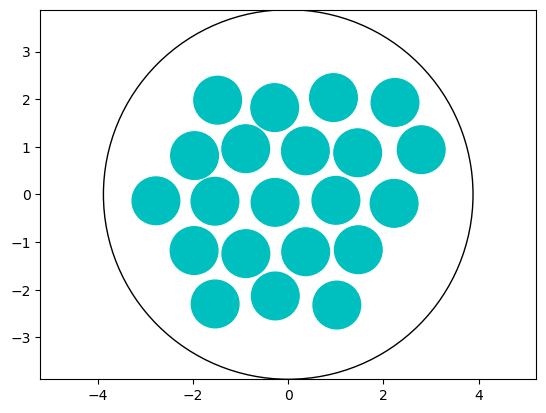

In [ ]:
try:
    from matplotlib.collections import PatchCollection
    circles = [plt.Circle((xi,yi), radius=R, lw=0)
               for xi,yi in zip(r[:,0,0], r[:,1,0])]
    circles_collection = PatchCollection(circles,color='c')
    plt.gca().add_collection(circles_collection);
except:
    plt.scatter(*r[...,0].T, s=10,);
plt.gca().add_patch(plt.Circle((0,0),radius=Rbox,fill=None));
plt.axis('equal');
plt.gca().set(xlim=(-Rbox,Rbox),ylim=(-Rbox,Rbox));

Substracting the center of mass can lead to put particles outside the boundary.
We replace them to lie inside.

In [ ]:
R2diff=(r[...,0]**2).sum(-1)-(Rbox-R)**2
R2diff_mask = R2diff>0
if np.any(R2diff_mask):
    print(R2diff)
    r[R2diff_mask,:,0] = r[R2diff_mask,:,0]*(1-R2diff[R2diff_mask,None]/(Rbox-R)**2)

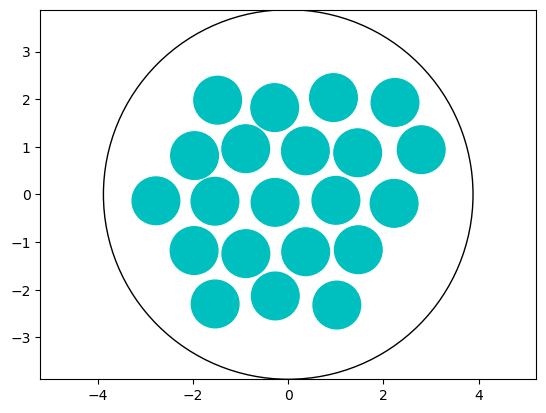

In [ ]:
try:
    from matplotlib.collections import PatchCollection
    circles = [plt.Circle((xi,yi), radius=R, lw=0)
               for xi,yi in zip(r[:,0,0], r[:,1,0])]
    circles_collection = PatchCollection(circles,color='c')
    plt.gca().add_collection(circles_collection);
except:
    plt.scatter(*r[...,0].T, s=10,);
plt.gca().add_patch(plt.Circle((0,0),radius=Rbox,fill=None));
plt.axis('equal');
plt.gca().set(xlim=(-Rbox,Rbox),ylim=(-Rbox,Rbox));

And check again there is no ovelap.

In [ ]:
if sum(pdist(r[:,0])<1.01*sigma)>0:
    r[...,0] = fill_circle_nooverlap(N,Rbox-R, sigma, p=r[...,0])
# check there are no overlaps of the particles
overlaps = sum(pdist(r[...,0])<1.01*sigma)
assert overlaps == 0, f'There are {overlaps = }.'

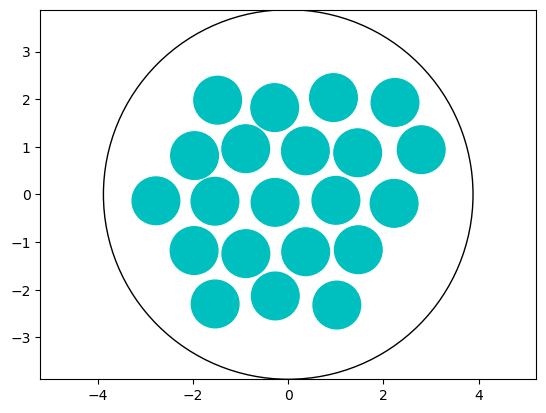

In [ ]:
try:
    from matplotlib.collections import PatchCollection
    circles = [plt.Circle((xi,yi), radius=R, lw=0)
               for xi,yi in zip(r[:,0,0], r[:,1,0])]
    circles_collection = PatchCollection(circles,color='c')
    plt.gca().add_collection(circles_collection);
except:
    plt.scatter(*r[...,0].T, s=10,);
plt.gca().add_patch(plt.Circle((0,0),radius=Rbox,fill=None));
plt.axis('equal');
plt.gca().set(xlim=(-Rbox,Rbox),ylim=(-Rbox,Rbox));

and substract the COM once more

In [ ]:
# center-of-mass COM
com = r[...,0].mean(0)
print(com)
if any(np.abs(com)>1e-14): r[...,0] -= com;
print(r[...,0].mean(0))

[-4.22942105e-17  1.05735526e-17]
[-4.22942105e-17  1.05735526e-17]


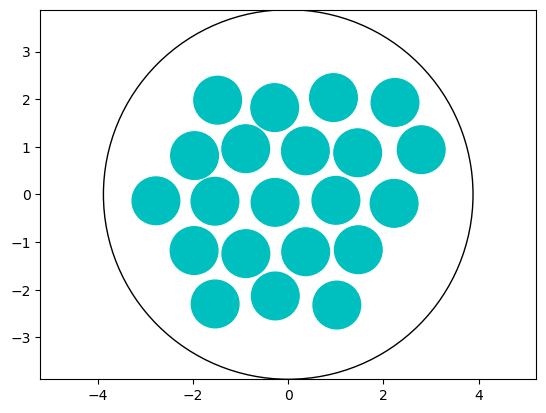

In [ ]:
try:
    from matplotlib.collections import PatchCollection
    circles = [plt.Circle((xi,yi), radius=R, lw=0)
               for xi,yi in zip(r[:,0,0], r[:,1,0])]
    circles_collection = PatchCollection(circles,color='c')
    plt.gca().add_collection(circles_collection);
except:
    plt.scatter(*r[...,0].T, s=10,);
plt.gca().add_patch(plt.Circle((0,0),radius=Rbox,fill=None));
plt.axis('equal');
plt.gca().set(xlim=(-Rbox,Rbox),ylim=(-Rbox,Rbox));

### initial velocity follows Maxwell-Boltzmann distribution

In [ ]:
# implementation modified from
# https://github.com/sheepforce/pysisyphus/blob/master/pysisyphus/dynamics/helpers.py

def kinetic_energy_from_vel_mass(v,m=1):
    """Kinetic energy for given velocities and masses.

    Parameters
    ----------
    velocities : 2d array, (number of atoms, Ndim)
        Atomic velocities.
    masses : 1d array, shape (number of atoms, )
        Atomic masses.

    Returns
    -------
    Ekin : float
        Kinetic energy.
    """
    Ekin = 0.5*m*(v*v) if np.isscalar(m) else 0.5*(m[:,None]*v*v)
    Ekin = Ekin.sum() if v.ndim<3 else Ekin.sum((0,1))
    return Ekin

def temperature_from_NK(N, Ekin, Ndf=3, kB=1):
    """Temperature for given atom number N and kinetic energy.

    For a monatomic perfect gas.

    Parameters
    ----------
    N : int
        Number of atoms. Each atom has three Ndf of freedom.
    Ekin : float
        Kinetic energy.
    fixed_dof : int, optional, default=0
        Number of fixed degrees of freedom, e.g. 3 when the center-of-mass
        velocity is removed.

    Returns
    -------
    Temperature : float
        Temperature in Kelvin.
    """
    return 2 * Ekin / (Ndf* N * kB)


def kinetic_energy_from_NT(N, T, Ndf=3, kB=1):
    """Kinetic energy for given number of atoms N and temperature T.

    Parameters
    ----------
    N : int
        Number of atoms.
    T : float
        Temperature in Kelvin.
    Ndf : int, optional, default=0
        Number of degrees of freedom.

    Returns
    -------
    E_kin : float
        Kinetic energy #in Hartree.
    """
    return 0.5*Ndf*N * T*kB

def vel_init_maxwell_boltzmann(N: int, T: float=1., m: float=1.,
                               kB: float=1., Ndim: int=2, verbose=0):
    """ Initializes a vector of N velocities in Ndim to temperature T
        following the Maxwell-Boltzmann distribution.
        This algorithm first samples from gaussian with $\sigma^2 = k_B T/m$,
        then removes the velocity of the center-of-mass (CM)
        and rescales to match the desired T.
    """
    # https://github.com/gromacs/gromacs/blob/main/src/gromacs/gmxpreprocess/gen_maxwell_velocities.cpp#L166
    std = np.sqrt(kB * T / m)
    velocities = np.random.normal(0, std, (N, Ndim)) # Generate velocities
    # remove the velocity of the center-of-mass for each axial component
    vcm = velocities.mean(0)
    velocities -= vcm
    # scale to input temperature
    K_ = kinetic_energy_from_vel_mass(velocities, m) # sum velocities of particles in Ndim dimensions at one timestep
    T_ = temperature_from_NK(N,K_,Ndim,kB)
    scale_from_T = np.sqrt(T/T_) # equal to scale_from_K
    K = kinetic_energy_from_NT(N,T, Ndf=Ndim)
    scale_from_K = np.sqrt(K/K_)
    velocities *= scale_from_T
    if verbose > 0:
        print(f'{T = }')
        print(' '*22 + r'$\Delta T  \Delta K  v_{CM}$')
        print(f'Generated velocities: {T-T_:<9.3g}  {K-K_:<9.3g} ', [f'{vcm[i]:<9.3g}' for i in range(Ndim)])
        print(f'Corrected velocities: {T- m * np.sum(velocities**2)/(N*Ndim*kB):<9.3g}  {K-kinetic_energy_from_vel_mass(velocities):<9.3g}  {velocities.mean(0)}')
    return velocities

In [ ]:
velocities_ = vel_init_maxwell_boltzmann(63*2*100, 0.85, Ndim=3)

In [ ]:
v[...,0] = vel_init_maxwell_boltzmann(N, Tin, m, kB, Ndim=d)

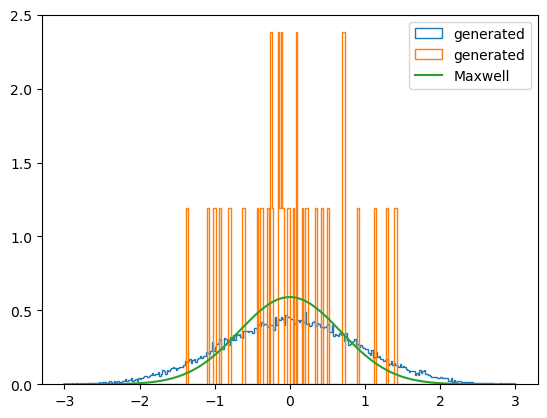

In [ ]:
plt.hist(velocities_.reshape(-1), 300, range=[-3,3], density=1, histtype='step', label='generated');
plt.hist(v[...,0].reshape(-1), 300, range=[-3,3], density=1, histtype='step', label='generated');
x = np.linspace(-3,3,100)
def mb_distro(v,T, k,m):    return np.sqrt(m / (2*np.pi*k*T)) * np.exp(-m*v**2 / (2*k*T))
maxwell = mb_distro(x,Tin, kb, m)
plt.plot(x,maxwell, label='Maxwell');
plt.legend();

## Simulate

In [ ]:
r.shape

(21, 2, 40000)

In [ ]:
assert r[0,0,0]!=0
assert v[0,0,0]!=0
r,v,Upot,forces,vrl= simulate_baoab(r, v, t_steps,
                                                      dt, sigma,eps,m, 2*Rbox,
                                                      rcut, Tin=Tin,
                                                      gamma=gamma,
                                                     )  # ~ 10s

  0%|          | 0/39999 [00:00<?, ?it/s]

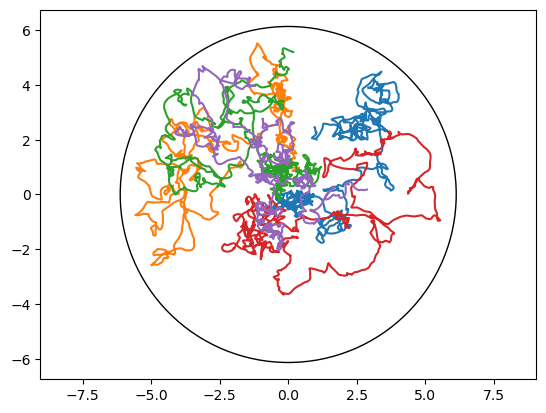

In [ ]:
for i in range(5):
    plt.plot(*r[i]);
plt.gca().add_patch(plt.Circle((0,0),radius=Rbox,fill=None));
plt.gca().axis('equal');

## Take snapshots

In [ ]:
r.shape,v.shape, e.shape

((21, 2, 40000), (21, 2, 40000), (420, 50))

In [ ]:
dt*100, t_steps/100

(np.float64(0.25), 400.0)

(2, 50)


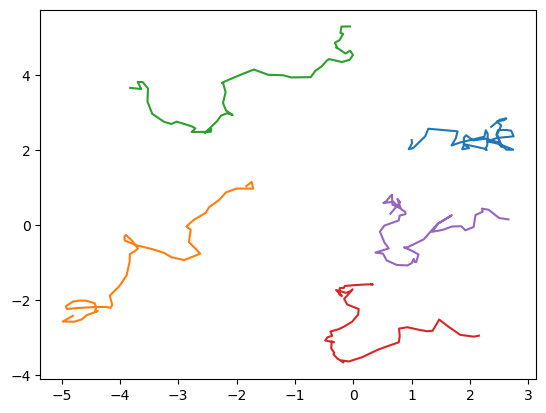

In [ ]:
ti,tf, ts = -100*50, None, 100
print(r[0,:,ti:tf:ts].shape)
for i in range(5):
    plt.plot(*r[i,:,ti:tf:ts]);

In [ ]:
t_slice = slice(ti,tf, ts)
t_slice

slice(-5000, None, 100)

(2, 50)


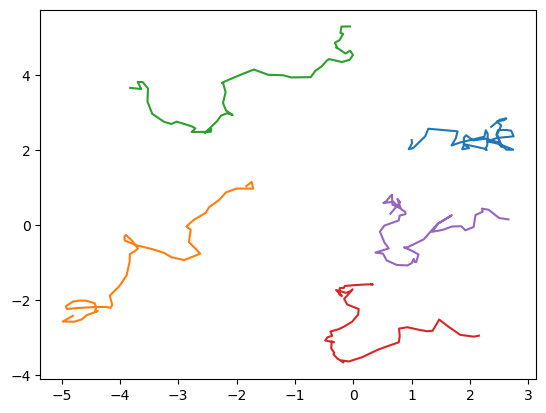

In [ ]:
ti,tf, ts = -100*50, None, 100
print(r[0,:,ti:tf:ts].shape)
for i in range(5):
    plt.plot(*r[i,:,ti:tf:ts]);

(2, 50)


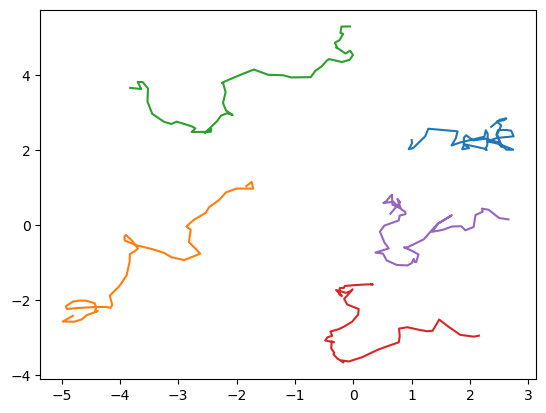

In [ ]:
ti,tf, ts = -100*50, None, 100
print(r[0,:,ti:tf:ts].shape)
for i in range(5):
    plt.plot(*r[i,:,ti:tf:ts]);

(2, 500)


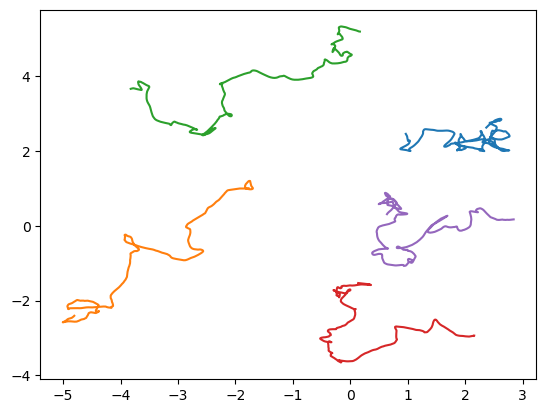

In [ ]:
ti,tf, ts = -100*50, None, 10
print(r[0,:,ti:tf:ts].shape)
for i in range(5):
    plt.plot(*r[i,:,ti:tf:ts]);

In [ ]:
pd = []
for i in range(N):
    all_minus_i = np.delete(np.arange(N),i)
    pd.append(np.linalg.norm(r[i]-r[all_minus_i],axis=1))

pd = np.concatenate(pd)
pd.shape

(420, 40000)

In [ ]:
e = (pd <= 2.5*sigma)*1.

In [ ]:
e.mean(), e[:,-5000::100].mean()

(np.float64(0.3205233333333333), np.float64(0.27314285714285713))

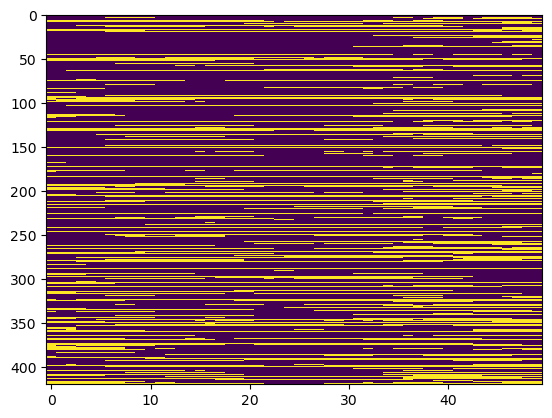

In [ ]:
plt.imshow(e[:,-5000::100], aspect='auto', interpolation='none');

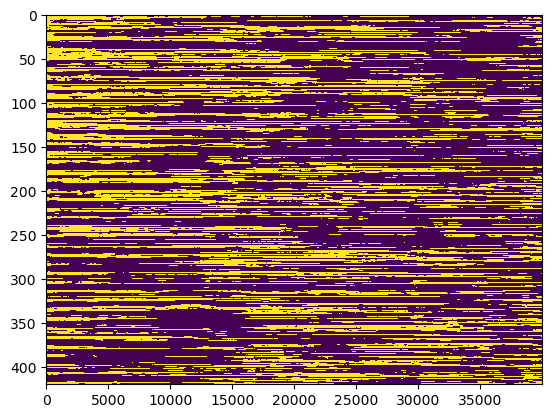

In [ ]:
plt.imshow(e, aspect='auto', interpolation='none');

In [ ]:
t_slice, r.shape, v.shape, e.shape

(slice(-5000, None, 100), (21, 2, 40000), (21, 2, 40000), (420, 40000))

In [ ]:
r_ = r[...,t_slice]
v_ = v[...,t_slice]
e_ = e[...,t_slice]

## Save train, validation, and test data sets in the same format of dNRI

In [ ]:
args['output_dir']

'../data/raw/synthLJ_21/'

In [ ]:
N = 21  # number of particles
d = 2   # number of dimensions # 2D gas
T = 500 # timeseries steps

# units system
sigma = 1. # particles diameter
m0 = 1.; eps = 1.
kb = kB = 1. # 1.380649e-23  # [J/K] Boltzmann constant
t0 = sigma*np.sqrt(m0/eps)
v0 = np.sqrt(eps/m0)
F0 = eps/sigma;
T0 = eps/kB;
m = m0

R = sigma/2. # particles radius
rcut = 2.5 * sigma  # LJ cutoff

rho = 0.12  #0.72 #  0.052 # 0.053  #9#0.8442
pf=0.74
Rbox = np.sqrt(N/(2*np.pi*rho*pf)) # radius of the boundaries
L = 2*Rbox

dt = 0.0025*t0 # 0.001*t0#0.005*t0#1e-4#0.001
t_steps = 40_000
t_int = np.arange(t_steps)*dt; # timestamp for positions
t_int_h = t_int - .5 * dt      # timestamp for velocity, kinetic and potential energies, forces, distances, and virial
# tsim should be on the order of 100 t0, this is 100 t0 /dt steps of dt
print(t0, 100*t0,100*t0/dt, t_steps, t_steps*dt)
assert t_steps*dt>50*t0 # 50 to have subsampling

Tin = 0.457 # 0.42 # 0.435 # 0.48   #0.85 #0.728 #0.85 #0.5*v**2 # kB *T /eps Temperature
gamma = 1.# friction constant, inverse of time
dump = 1./gamma #

bcond = "Reflective circle"  # "pbc"

1.0 100.0 40000.0 40000 100.0


In [ ]:
Rbox

np.float64(6.134981116414218)

In [ ]:
np.random.seed(1)

num_sims = args['num_train'] + args['num_val'] + args['num_test']
E = N*(N-1) # Fully connected without self-connection
all_data, all_edges = np.zeros((num_sims, N,d*2,T), dtype=float) , np.zeros((num_sims, E,T), dtype=float)


for sim in trange(num_sims):
    # initialize system
    r = np.zeros((N,d,t_steps), dtype=float) # position
    v = np.zeros((N,d,t_steps), dtype=float) # velocity
    # initialize positions
    r[...,0] = lattice_hex(R,Rbox*1.5,s=2.5)[:N] #fill_circle_nooverlap(N,Rbox-R, sigma)
    # check there are no overlaps of the particles
    overlaps = sum(pdist(r[...,0])<1.01*sigma)
    assert overlaps == 0, f'There are {overlaps = } at init.'
    # sustract center-of-mass COM
    com = r[...,0].mean(0)
    if any(np.abs(com)>1e-14): r[...,0] -= com;
    # avoid particle outside border
    R2diff=(r[...,0]**2).sum(-1)-(Rbox-R)**2
    R2diff_mask = R2diff>0
    if np.any(R2diff_mask):
        print(R2diff)
        r[R2diff_mask,:,0] = r[R2diff_mask,:,0]*(1-R2diff[R2diff_mask,None]/(Rbox-R)**2)
    # avoid overlap
    if sum(pdist(r[:,0])<1.01*sigma)>0:
        r[...,0] = fill_circle_nooverlap(N,Rbox-R, sigma, p=r[...,0])
    # check there are no overlaps of the particles
    overlaps = sum(pdist(r[...,0])<1.01*sigma)
    assert overlaps == 0, f'There are {overlaps = } after COM.'
    # assure center-of-mass COM
    com = r[...,0].mean(0)
    if any(np.abs(com)>1e-14): r[...,0] -= com;
    # initilize velocities
    v[...,0] = vel_init_maxwell_boltzmann(N, Tin, m, kB, Ndim=d)

    # simulate evolution
    assert r[0,0,0]!=0
    assert v[0,0,0]!=0

    r,v,Upot,forces,vrl= simulate_baoab(r, v, t_steps,
                                      dt, sigma,eps,m, 2*Rbox,
                                      rcut, Tin=Tin,
                                      gamma=gamma,
                                     )
    # edges interactions
    pd = []  # pair-wise distances
    for i in range(N):
        all_minus_i = np.delete(np.arange(N),i)
        pd.append(np.linalg.norm(r[i]-r[all_minus_i],axis=1))

    pd = np.concatenate(pd)
    e = (pd <= 2.5*sigma)*1.

    # take the last snapshots every tenth
    t_slice = slice(-T*10, None, 10)
    r_ = r[...,t_slice]  # N,2,T
    v_ = v[...,t_slice]  # N,2,T
    e_ = e[...,t_slice]  # E,T

    # join features
    node_feats = np.concatenate((r_,v_),axis=1)
    all_data[sim]  = node_feats     # num_sims, (N, F=4, T)
    all_edges[sim] = e_             # num_sims, E, T

  0%|          | 0/2400 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

  0%|          | 0/39999 [00:00<?, ?it/s]

In [ ]:
all_data = np.stack(all_data)
all_edges = np.stack(all_edges)

In [ ]:
all_edges.mean()

np.float64(0.2948312142857143)

In [ ]:
all_data.shape

(2400, 21, 4, 500)

In [ ]:
np.unique(all_data, axis=0).shape

(2400, 21, 4, 500)

In [ ]:
np.allclose(all_data[0], all_data[1])

False

In [ ]:
j=0

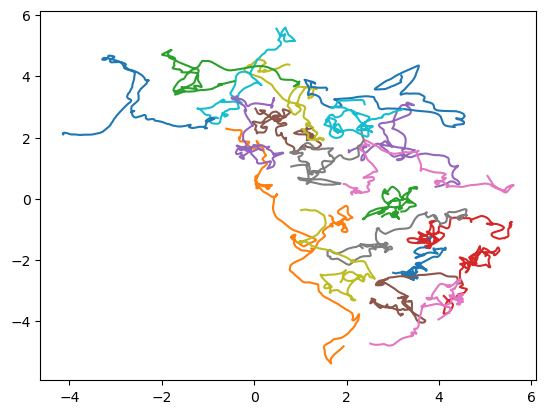

In [ ]:
j+=1
for i in range(21):
    plt.plot(*all_data[j,i,:2]);

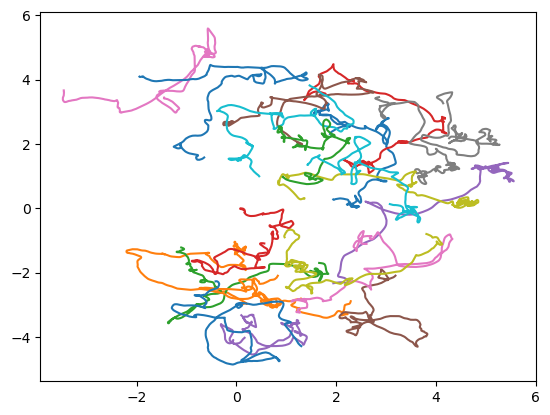

In [ ]:
j+=1
for i in range(21):
    plt.plot(*all_data[j,i,:2]);

In [ ]:
all_edges.shape

(2400, 420, 500)

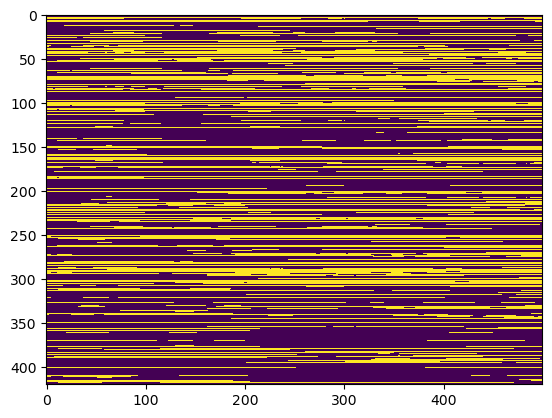

In [ ]:
j+=1
plt.imshow(all_edges[j], aspect='auto', interpolation='none');

In [ ]:
import torch

In [ ]:
from pathlib import Path

In [ ]:
all_data = all_data.transpose(0,3,1,2)

In [ ]:
all_edges = all_edges.transpose(0,2,1)

In [ ]:
all_edges.shape, all_data.shape

((2400, 500, 420), (2400, 500, 21, 4))

In [ ]:
assert np.all(np.isfinite(all_data))

In [ ]:
assert np.all(np.isfinite(all_edges))

In [ ]:
args['output_dir']

'../data/raw/synthLJ_21/'

In [ ]:
out_dir = Path(args['output_dir'])
out_dir.mkdir(parents=True, exist_ok=True)
train_path = out_dir/'train_feats'
val_path   = out_dir/'val_feats'
test_path  = out_dir/'test_feats'
train_data = torch.FloatTensor(all_data[:args['num_train']])
val_data   = torch.FloatTensor(all_data[args['num_train']:args['num_train']+args['num_val']])
test_data  = torch.FloatTensor(all_data[args['num_train']+args['num_val']:])


torch.save(train_data, train_path)
torch.save(val_data, val_path)
torch.save(test_data, test_path)

train_edges = torch.FloatTensor(all_edges[:args['num_train']])
val_edges   = torch.FloatTensor(all_edges[args['num_train']:args['num_train']+args['num_val']])
test_edges  = torch.FloatTensor(all_edges[args['num_train']+args['num_val']:])
train_path = out_dir/'train_edges'
val_path   = out_dir/'val_edges'
test_path  = out_dir/'test_edges'


torch.save(train_edges, train_path)
torch.save(val_edges, val_path)
torch.save(test_edges, test_path)

# Animation

In [ ]:
import numpy as np

In [ ]:
import matplotlib.pyplot as plt
from matplotlib import animation
# https://stackoverflow.com/a/11041426/
# https://stackoverflow.com/a/48794769/
# https://www.johnaparker.com/blog/circle-graphics
from matplotlib.collections import PatchCollection
from matplotlib.patches import Circle, Wedge
from functools import partial

In [ ]:
class UpdatablePatchCollection(PatchCollection):
    def __init__(self, patches, *args, **kwargs):
        self.patches = patches
        PatchCollection.__init__(self, patches, *args, **kwargs)

    def get_paths(self):
        self.set_paths(self.patches)
        return self._paths

In [ ]:
ori = np.arctan2(v[:,1], v[:,0]); ori.shape

(21, 40000)

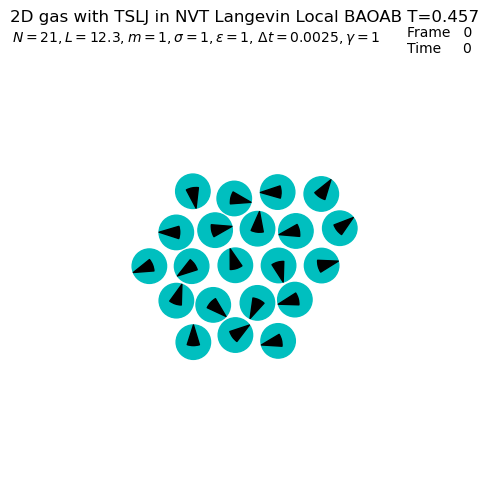

In [ ]:
def animated_particles(pos,ori, R,):
    circles = [Circle((xi,yi), radius=R, lw=0)
               for xi,yi in zip(pos[:,0], pos[:,1])]
    circles_collection = UpdatablePatchCollection(circles,color='c')

    wedges  = [Wedge((xi+R*np.cos(ti),yi+R*np.sin(ti)),
                     R*1.2, np.rad2deg(ti-.3)+180, np.rad2deg(ti+.3)+180,)
               for xi,yi,ti in zip(pos[:,0], pos[:,1], ori)]
    wedges_collection = UpdatablePatchCollection(wedges,color='k')
    return circles_collection,circles, wedges_collection, wedges

save_every = 1
fig, ax = plt.subplots(figsize=(6,6))
ax.set_axis_off()
#ax.set(xlim=[xmin,xmax], ylim=[ymin,ymax]);
ax.margins(0.05)
i=0 #  30_000  #-1
circles_collection,circles, wedges_collection,wedges = animated_particles(r[...,i], ori[...,i], R,)
ax.add_collection(circles_collection); ax.add_collection(wedges_collection);
ax.axis("equal");
text_ = ax.text(0.85,.95,f'Frame {0:3.3g}\nTime   {0:3.3g}',transform=ax.transAxes, ha='left');
ax.set_title(f"2D gas with TSLJ in NVT Langevin Local BAOAB T={Tin}");
ax.axhline( L/2, alpha=0); ax.axvline( L/2, alpha=0);
ax.axhline(-L/2, alpha=0); ax.axvline(-L/2, alpha=0);
ax.text(0,1,fr'${N = }, {L = :.3g}$'+\
        #fr'$, {v = :.3g},
        fr'$, {m = :g}, \sigma = {sigma:g}, \epsilon =  {eps:g}$'
        fr', $\Delta t = {dt}, \gamma={gamma:g}$'
        ,transform=ax.transAxes, va='top');

In [ ]:
def update_particles(i, save_every, R=1, subsample=1, start_t=0):
    i=i+start_t
    #circles_collection.set_offsets(pos[...,i])
    for p in range(r.shape[0]):
        xi,yi,ti = r[p,0,i*subsample], r[p,1,i*subsample], ori[p,i*subsample]
        circles[p].set_center((xi,yi))
        wedges[p].set_center((xi+R*np.cos(ti),yi+R*np.sin(ti)))
        wedges[p].set_theta1(np.rad2deg(ti-.3)+180)
        wedges[p].set_theta2(np.rad2deg(ti+.3)+180)
    text_.set_text(f'Frame {i:3.3g}\nTime   {i*dt*save_every*subsample:3.3g}');
    return circles_collection, wedges_collection, text_

In [ ]:
# to see the animation in the jupyter notebook
# https://stackoverflow.com/a/43447370/
plt.rcParams["animation.html"] = "jshtml"

In [ ]:
t_steps = r.shape[-1]

In [ ]:
t_steps

40000

In [ ]:
Nframes = 400
subsamples = t_steps//Nframes//2 # 99
print(f'{subsamples=}')
assert Nframes*subsamples <= r.shape[-1]
start_t = r.shape[-1]//subsamples-Nframes
ani = animation.FuncAnimation(fig,partial(update_particles,save_every=save_every, R=R, subsample=subsamples, start_t=start_t),frames=Nframes,blit=True,interval=10)

subsamples=50


In [ ]:
ani

Animation size has reached 20986760 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [ ]:
fname = args['output_dir']+"gas2D_LJ_reflective_circle_N21_T0457.gif"

In [ ]:
# Save Video
import os
if not os.path.exists(fname):    ani.save(fname)

In [ ]:
print(fname)

../data/raw/synthLJ_21/gas2D_LJ_reflective_circle_N21_T0457.gif
